Parkinson's Disease vs Normal Walking Detection.

In [1]:
# -- IMPORTS START --
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

import os
import re
import warnings
import datetime
import pathlib
import glob
import numpy as np
import pandas as pd
import joblib
import pickle
from scipy import signal
from sklearn import metrics
from sklearn import tree

from sklearn import tree, metrics
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from scipy.fft import fft, fftfreq
from scipy.signal import butter, filtfilt, find_peaks
# -- IMPORTS END --

In [2]:
# -- WARNINGS START --
from pandas.errors import SettingWithCopyWarning

warnings.simplefilter(action='ignore', category=SettingWithCopyWarning)
# -- WARNINGS END --

These methods are used for processing the raw CSV files.

Calc Magnitude, and Remove Sensor Noise, and Get Dominant Frequency.

In [3]:
def calc_magnitude(data):
    # Calculate magnitude 
    data['magnitude'] = np.sqrt(data['x']**2 + data['y']**2 + data['z']**2) # absolute accel magnitude
    data['magnitude'] = data['magnitude'] - data['magnitude'].mean() # detrend: "remove gravity"
    return data

In [4]:
def remove_accel_noise(data, sampling_rate):
    
    # Low pass filter
    cutoff = 3 # Hz
    order = 2
    b, a = butter(order, cutoff/(sampling_rate/2), btype='lowpass')
    data['filtered_mag'] = filtfilt(b, a, data['magnitude'])
    return data

def remove_gyro_noise(data, sampling_rate):

    # Low pass filter
    cutoff = 3 # Hz
    order = 2
    b, a = butter(order, cutoff/(sampling_rate/2), btype='lowpass')
    data['filtered_mag'] = filtfilt(b, a, data['magnitude'])
    return data

In [5]:
def get_dominant_freq(data):
    
    N = len(data)
    T = 0.01 # 100 Hz, 0.01 second per sample

    mag = data['filtered_mag']
    yf = fft(mag)
    xf = fftfreq(N, T)[:N//2]

    peaks, _ = find_peaks(np.abs(yf[:N//2]), height=0)
    dominant_freq = xf[peaks[np.argmax(np.abs(yf[peaks]))]]

    data['dominant_freq'] = dominant_freq

    return data

In [6]:
def get_signal_energy(data):

    mag = data['filtered_mag']
    yf = fft(mag)

    data['signal_energy'] = np.sum(np.abs(yf)**2) / len(yf)

    return data

Change SensorLogger time to datetime format.

In [7]:
def transform_time_to_datetime(root):
    
    sensor_folders = [f.name for f in os.scandir(root) if f.is_dir()]

    for sensor_folder in sensor_folders:

        class_folders = os.listdir(f'{root}/{sensor_folder}')
        
        for class_folder in class_folders:

            files = os.listdir(f'{root}/{sensor_folder}/{class_folder}')

            for filename in files:

                df = pd.read_csv(f'{root}/{sensor_folder}/{class_folder}/{filename}', parse_dates=['time'])
                df['time'] = pd.to_datetime(pd.to_numeric(df['time']), unit='ns')
                df.to_csv(f'{root}/{sensor_folder}/{class_folder}/{filename}', index=False)


Aggregate sensor data to combined CSVs.

In [8]:
def all_data_to_combined_csv(root):

    sensor_folders = [f.name for f in os.scandir(root) if f.is_dir()]

    accel_data = pd.DataFrame()
    gyro_data = pd.DataFrame()
    
    for s in range(len(sensor_folders)):

        class_folders = os.listdir(f'{root}/{sensor_folders[s]}')

        for c in range(len(class_folders)):

            for file in os.listdir(f'{root}/{sensor_folders[s]}/{class_folders[c]}'):

                data = pd.read_csv(f'{root}/{sensor_folders[s]}/{class_folders[c]}/{file}', parse_dates=['time'], date_format="%Y-%m-%d %H:%M:%S.%f").set_index('time')
                
                data = calc_magnitude(data)
                if s == 0:
                    data = remove_accel_noise(data, 100)
                else:
                    data = remove_gyro_noise(data, 100)
                data = get_dominant_freq(data)
                data = get_signal_energy(data)

                data['label'] = "Healthy" if c == 0 else "Parkinsons"

                if s == 0:
                    accel_data = pd.concat([accel_data, data])
                else:
                    gyro_data = pd.concat([gyro_data, data])

    accel_data.to_csv(f'{root}/all_accel_data.csv')
    gyro_data.to_csv(f'{root}/all_gyro_data.csv')

Show Acceleration v. Time plots for 8 random windows in individual file (unfiltered + filtered) and aggregated files (filtered).

In [9]:
def plot_file_data(data, window_sec, sample_rate, file, sensor):

    WINDOW_LEN = int(window_sec * sample_rate)  # ticks

    # Set number of windows
    NUM_WINDOWS = 4

    fig, axes = fig, [(ax1, ax2, ax3, ax4), (filt_ax1, filt_ax2, filt_ax3, filt_ax4)] = plt.subplots(nrows = 2, ncols = 4, figsize =(16, 5))

    for i in range(NUM_WINDOWS):
        
        # Select random window
        start = np.random.randint(0, len(data) - WINDOW_LEN)
        end = start + WINDOW_LEN
        window = data.iloc[start:end]

        # Plot data
        axes[0][i].set_xticklabels([])
        axes[1][i].set_xticklabels([])

        window = calc_magnitude(window)
        if sensor == "Accelerometer":
            window = remove_accel_noise(window, sample_rate)
        else:
            window = remove_gyro_noise(window, sample_rate)
            
        axes[0][i].plot(window.index, window['magnitude'], label='Magnitude')
        axes[1][i].plot(window.index, window['filtered_mag'], label='Filtered Mag.')

        axes[0][i].legend()
        axes[1][i].legend()

        axes[0][i].set_title(f"Rand. 10s Window {i+1}")
        axes[1][i].set_title(f"Rand. 10s Window {i+1}")

    fig.tight_layout()
    fig.subplots_adjust(top=0.85)
    fig.suptitle(f"{file}")

In [10]:
def plot_all_data(data, window_sec, sample_rate, sensor):
    
    WINDOW_LEN = int(window_sec * sample_rate)  # ticks
    # Set number of windows
    NUM_WINDOWS = 8

    fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(20, 5))

    for i in range(NUM_WINDOWS):

        # Select random window
        start = np.random.randint(0, len(data) - WINDOW_LEN)
        end = start + WINDOW_LEN
        window = data.iloc[start:end]

        ax = axs.flat[i]
        ax.set_xticklabels([])

        # Plot data
        ax.plot(window.index, window['filtered_mag'], label='Mag')

        # not sure how to add the activity to just the label or something and not plot it
        ax.plot(window.index, window['label'], label='Class')
        
        ax.set_title(f"Rand. 30s Window {i+1}")
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.88)
    fig.suptitle(f"All {sensor} Data")

Show Magnitude v. Frequency plots for individual file (unfiltered + filtered).

In [11]:
def plot_file_fft(data, filename, sensor_folder):
    
    data = calc_magnitude(data)
    if sensor_folder == "Accelerometer":
        data = remove_accel_noise(data, 100)
    else:
        data = remove_gyro_noise(data, 100)
    
    N = len(data)
    T = 0.01 # 100 Hz, 0.01 second per sample

    xf = fftfreq(N, T)[:N//2]

    yf = fft(data['magnitude'])
    filt_yf = fft(data['filtered_mag'])

    fig, axes = fig, [(ax1, ax2), (filt_ax1, filt_ax2)] = plt.subplots(nrows = 2, ncols = 2, figsize =(16, 5))

    for row_i in range(len(axes)):
        for ax in axes[row_i]:
            if row_i == 0:
                ax.plot(xf, np.abs(yf[:N//2]))
            else:
                ax.plot(xf, np.abs(filt_yf[:N//2]))
            ax.set_xlabel('Frequency (Hz)')
            ax.set_ylabel('Magnitude')
            ax.use_sticky_edges = False
            ax.set_xmargin(0)

    ax1.set_title('FFT with Frequencies')
    ax1.set_xlim(right=10)
    ax2.set_title('FFT with More Frequencies')
    ax2.set_xlim(right=5)

    filt_ax1.set_title('Filtered FFT with Frequencies')
    filt_ax1.set_xlim(right=10)
    filt_ax2.set_title('Filtered FFT with More Frequencies')
    filt_ax2.set_xlim(right=5)

    plt.tight_layout()
    plt.subplots_adjust(top=0.88)
    fig.suptitle(f'{filename}')

Accelerometer Features

In [12]:
def accel_add_features(window):
    features = []
    features.append([window['filtered_mag'].mean(), window['filtered_mag'].max(), window['filtered_mag'].median(), window['filtered_mag'].min(),
                     window['filtered_mag'].quantile(q=0.25), window['filtered_mag'].quantile(q=0.75), window['filtered_mag'].std(),
                     window['dominant_freq'].iloc[0], window['signal_energy'].iloc[0]])
    features_df = pd.DataFrame(features, columns=['avg', 'max', 'med', 'min', 'q25', 'q75', 'std', 'dominant_freq', 'signal_energy']) #change features needed
    return features_df

Gyroscope Features

In [13]:
def gyro_add_features(window):
    features = []
    features.append([window['filtered_mag'].mean(), window['filtered_mag'].max(), window['filtered_mag'].median(), window['filtered_mag'].min(),
                     window['filtered_mag'].quantile(q=0.25), window['filtered_mag'].quantile(q=0.75), window['filtered_mag'].std(), 
                     window['dominant_freq'].iloc[0], window['signal_energy'].iloc[0]])
    features_df = pd.DataFrame(features, columns=['avg', 'max', 'med', 'min', 'q25', 'q75', 'std', 'dominant_freq', 'signal_energy']) #change features needed
    return features_df

Extract features.

In [14]:
def extract_features(accel_data, gyro_data, window_sec, sample_rate, window_type='consecutive'):
    
    df = pd.DataFrame()
    
    if window_type == 'consecutive':
        accel_data_windows = accel_data.resample(f'{window_sec}s')
        gyro_data_windows = gyro_data.resample(f'{window_sec}s')
    elif window_type == 'rolling':
        window_size = window_sec * sample_rate
        accel_data_windows = accel_data.rolling(window=window_size, step=window_size//2)
        gyro_data_windows = gyro_data.rolling(window=window_size, step=window_size//2)
    else:
        raise ValueError('Invalid window type')

    for accel_window, gyro_window in zip(accel_data_windows, gyro_data_windows):

        if window_type == 'consecutive':
            accel_window = accel_window[1]
            gyro_window = gyro_window[1]

        if accel_window.empty or gyro_window.empty:
            continue

        accel_fts = accel_add_features(accel_window)
        gyro_fts = gyro_add_features(gyro_window)

        window_fts = accel_fts.join(gyro_fts, lsuffix='_accel', rsuffix='_gyro')
        
        window_fts['label'] = accel_window['label'].iloc[0]
        
        df = pd.concat([df, window_fts], ignore_index=True)
    
    return df

Show Max Tree Depth v. Accuracy plots.

In [15]:
def show_depth_accuracy(feature_frames, num_trees):

    features = feature_frames[feature_frames.columns[:-1]]
    labels = feature_frames['label']

    features_train_set, features_test_set, labels_train_set, labels_test_set = train_test_split(features, labels, test_size=0.3, random_state=42)
    
    depths = range(1, 11)
    scores = []
    for d in depths:
        if num_trees == 1:
            clf = DecisionTreeClassifier(criterion='entropy',max_depth=d).fit(features_train_set, labels_train_set)
        else:
            clf = RandomForestClassifier(n_estimators=num_trees, criterion='entropy', max_depth=d).fit(features_train_set, labels_train_set)
        # Compute cross-val score
        score = cross_val_score(clf, feature_frames.drop(columns=['label'], inplace=False), feature_frames['label'], cv=5).mean() 
        scores.append(score)

    # Plot scores  
    plt.figure(figsize=(10,3))
    plt.plot(depths, scores)
    plt.xlabel("Max Depth")
    plt.ylabel("Avg Cross-Val Score")

Train Decision Tree.

In [16]:
def train_decision_tree(feature_frames, num_trees, depth):

    features = feature_frames[feature_frames.columns[:-1]]
    labels = feature_frames['label']

    features_train_set, features_test_set, labels_train_set, labels_test_set = train_test_split(features, labels, test_size=0.3, random_state=42)

    if num_trees == 1:
        dt_model = DecisionTreeClassifier(criterion='entropy', max_depth=depth, min_samples_leaf=20).fit(features_train_set, labels_train_set)
    else:
        dt_model = RandomForestClassifier(n_estimators=num_trees, criterion='entropy', max_depth=depth).fit(features_train_set, labels_train_set)
    dt_pred = dt_model.predict(features_test_set)

    acc = dt_model.score(features_test_set, labels_test_set)
    cross_val_acc = cross_val_score(dt_model, feature_frames.drop(columns=['label'], inplace=False), feature_frames['label'], cv=5).mean() 
    dt_cm = confusion_matrix(labels_test_set, dt_pred, labels=dt_model.classes_)
    print(classification_report(labels_test_set, dt_pred))
    print("Accuracy on test set:", acc)
    print("Cross Validation Acc:", cross_val_acc)

    return dt_model, dt_cm, acc

Show Feature Importance Ranking.

In [17]:
def show_feature_importance(clf, features):   
    # Feature importance
    importances = clf.feature_importances_

    # Sort feature importances in descending order
    sorted_idx = np.argsort(importances)
    sorted_importances = importances[sorted_idx]
    sorted_feature_names = features[sorted_idx]

    # Plot feature importances as a horizontal bar graph
    plt.figure(figsize=(8, 4))
    y_pos = np.arange(len(sorted_feature_names))
    plt.barh(y_pos, sorted_importances)
    plt.yticks(y_pos, sorted_feature_names)
    plt.xlabel('Importance')
    plt.title('Feature Importance')
    plt.tight_layout()

Visualize Decision Tree Classifier.

In [18]:
def show_decision_tree(dt_model, features_frames, cnames):
    
    feature_names = features_frames.columns.tolist()
    
    fig, ax = plt.subplots(figsize=(20,6))
    tree.plot_tree(dt_model,
                   feature_names=feature_names,
                   class_names=cnames,
                   filled=True,
                   ax=ax)
    plt.title('Parkinson\'s Decision Tree from Accel. + Gyro. Data')
    plt.savefig('dt.png')

Reformat and Aggregate Collected Data.

In [19]:
# Combine all the data under data/Activities
# transform_time_to_datetime('./Data')

all_data_to_combined_csv(root='./Data')

all_accel_data = pd.read_csv('./Data/all_accel_data.csv', parse_dates=['time']).set_index('time')
all_gyro_data = pd.read_csv('./Data/all_gyro_data.csv', parse_dates=['time']).set_index('time')

Show 6 random 10s windows (filtered and unfiltered) and the fft for a random file for each sensor + class folder.

Show 8 random 30s windows (filtered) for each all_{sensor}_data file

plotting Ben_Healthy_1_Accelerometer.csv...
plotting Ben_Healthy_2_Accelerometer.csv...
plotting Ben_Healthy_3_Accelerometer.csv...
plotting Ben_Healthy_4_Accelerometer.csv...
plotting Ben_Healthy_5_Accelerometer.csv...
plotting Ian_Healthy_1_Accelerometer.csv...
plotting Ian_Healthy_2_Accelerometer.csv...
plotting Ian_Healthy_3_Accelerometer.csv...
plotting Ian_Healthy_4_Accelerometer.csv...
plotting Ian_Healthy_5_Accelerometer.csv...
plotting Jonathan_Healthy_1_Accelerometer.csv...


C:\Users\Ian McKenna\AppData\Local\Temp\ipykernel_18504\3275720183.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = fig, [(ax1, ax2, ax3, ax4), (filt_ax1, filt_ax2, filt_ax3, filt_ax4)] = plt.subplots(nrows = 2, ncols = 4, figsize =(16, 5))


plotting Jonathan_Healthy_2_Accelerometer.csv...
plotting Jonathan_Healthy_3_Accelerometer.csv...
plotting Jonathan_Healthy_4_Accelerometer.csv...
plotting Jonathan_Healthy_5_Accelerometer.csv...
plotting Ben_Parkinsons_1_Accelerometer.csv...
plotting Ben_Parkinsons_2_Accelerometer.csv...
plotting Ben_Parkinsons_3_Accelerometer.csv...
plotting Ben_Parkinsons_4_Accelerometer.csv...
plotting Ben_Parkinsons_5_Accelerometer.csv...
plotting Ian_Parkinsons_1_Accelerometer.csv...
plotting Ian_Parkinsons_2_Accelerometer.csv...
plotting Ian_Parkinsons_3_Accelerometer.csv...
plotting Ian_Parkinsons_4_Accelerometer.csv...
plotting Ian_Parkinsons_5_Accelerometer.csv...
plotting Jonathan_Parkinsons_1_Accelerometer.csv...
plotting Jonathan_Parkinsons_2_Accelerometer.csv...
plotting Jonathan_Parkinsons_3_Accelerometer.csv...
plotting Jonathan_Parkinsons_4_Accelerometer.csv...
plotting Jonathan_Parkinsons_5_Accelerometer.csv...
plotting Ben_Healthy_1_Gyroscope.csv...
plotting Ben_Healthy_2_Gyroscope.c

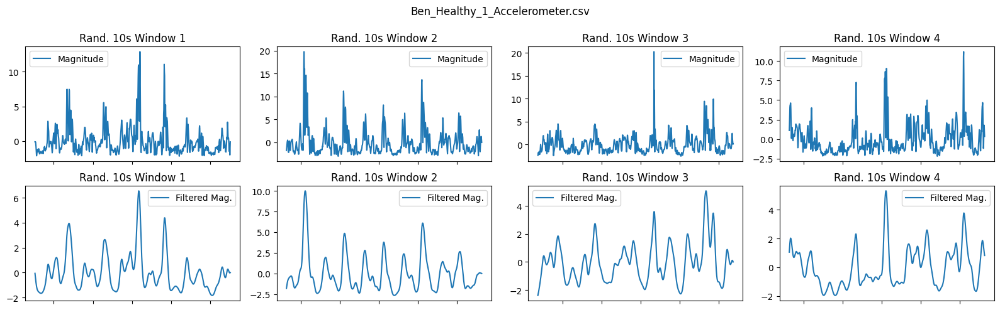

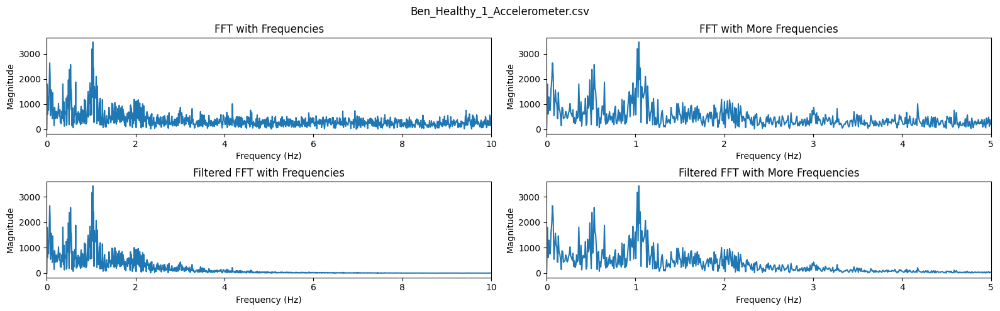

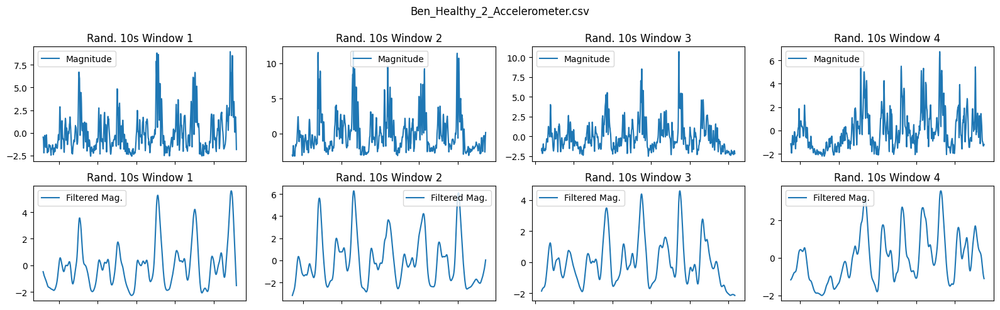

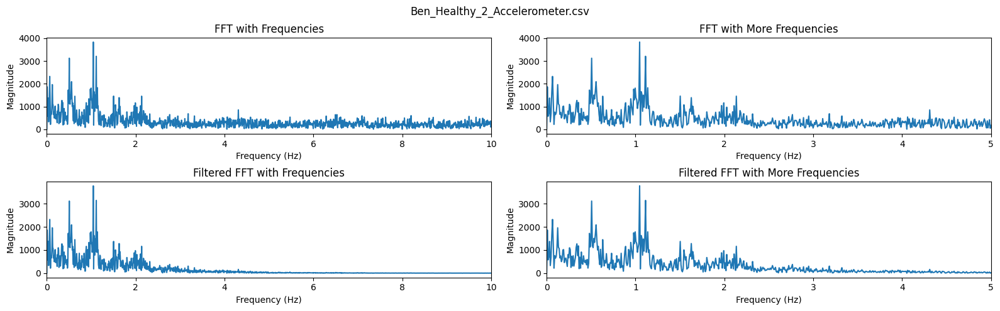

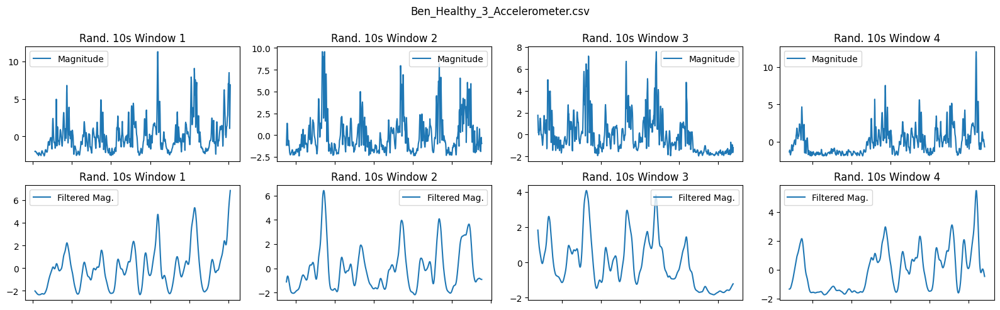

...

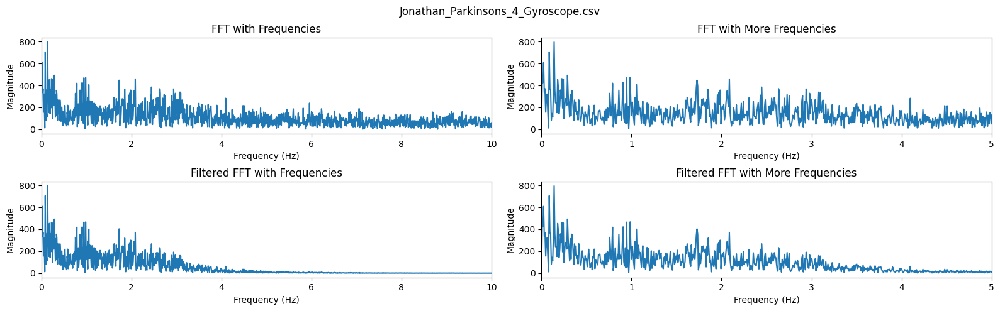

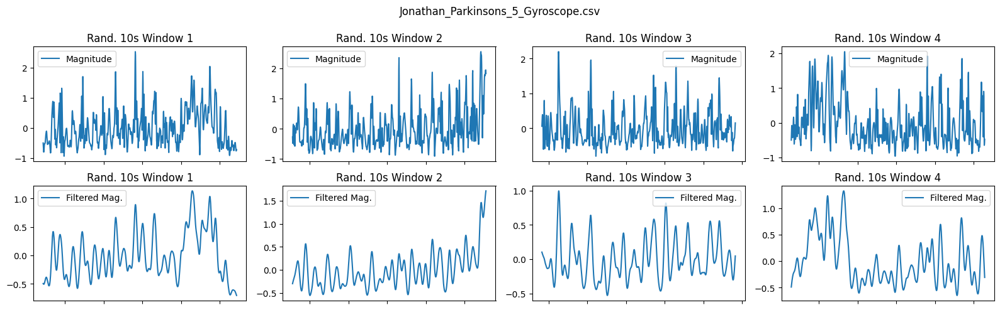

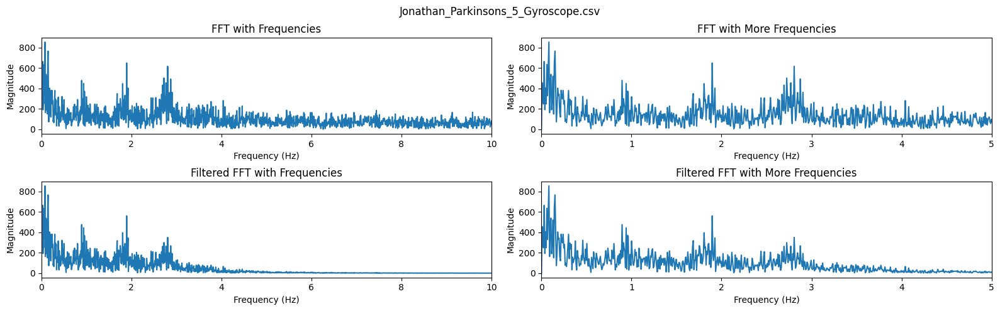

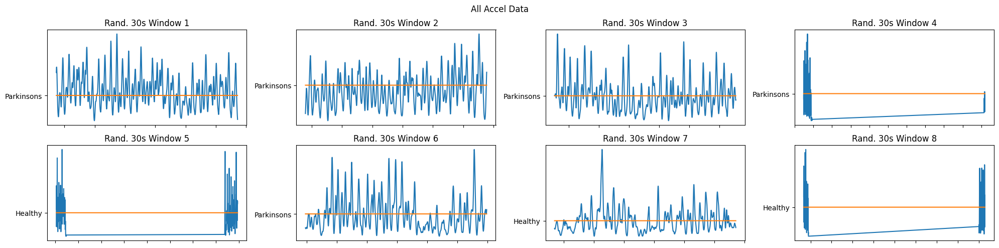

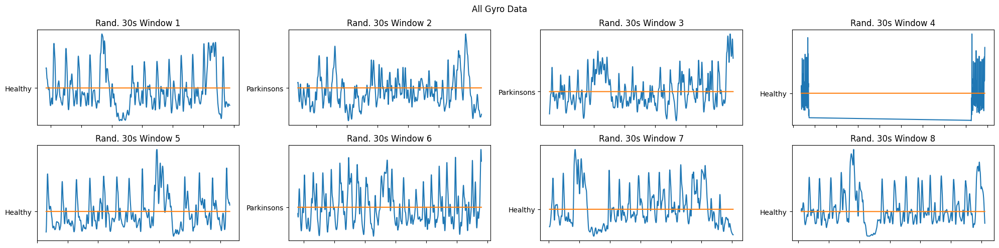

In [20]:
def display_data():
    sensor_folders = [f.name for f in os.scandir("./Data") if f.is_dir()]

    for sensor_folder in sensor_folders:

        class_folders = os.listdir(f'{"./Data"}/{sensor_folder}')

        for class_folder in class_folders:

            files = os.listdir(f'{"./Data"}/{sensor_folder}/{class_folder}')

            # file = files[np.random.randint(0, len(files))]
            # data = pd.read_csv(f'{"./Data"}/{sensor_folder}/{class_folder}/{file}')
            # plot_file_data(data, 10, 100, file, sensor_folder)
            # plot_file_fft(data, file, sensor_folder)

            for file in files:
                print(f"plotting {file}...")
                data = pd.read_csv(f'{"./Data"}/{sensor_folder}/{class_folder}/{file}')
                plot_file_data(data, 10, 100, file, sensor_folder)
                plot_file_fft(data, file, sensor_folder)

    plot_all_data(all_accel_data, 30, 100, "Accel")
    plot_all_data(all_gyro_data, 30, 100, "Gyro")

display_data()

Set model parameters. Multiple blocks for easy modulation.

In [21]:
MODEL = "1.0: ALL FEATURES" # all implemented features

WINDOW_SIZE = 6
WINDOW_TYPE = 'rolling'

NUM_TREES = 100
MAX_DEPTH = 4

TRAINING_FEATURES = ["avg_accel", "max_accel", "med_accel", "min_accel", "q25_accel", "q75_accel", "std_accel", "dominant_freq_accel", "signal_energy_accel",
                     "avg_gyro",  "max_gyro",  "med_gyro",  "min_gyro",  "q25_gyro",  "q75_gyro",  "std_gyro",  "dominant_freq_gyro",  "signal_energy_gyro"]

In [22]:
MODEL = "1.1: ALL FEATURES" # focused features

WINDOW_SIZE = 6
WINDOW_TYPE = 'rolling'

NUM_TREES = 100
MAX_DEPTH = 3

TRAINING_FEATURES = ["min_accel", "dominant_freq_accel", "signal_energy_accel",
                     "max_gyro",  "std_gyro",            "signal_energy_gyro"]

In [23]:
MODEL = "2.0: NO SIG NRG" # no signal energies

WINDOW_SIZE = 6
WINDOW_TYPE = 'rolling'

NUM_TREES = 100
MAX_DEPTH = 4

TRAINING_FEATURES = ["avg_accel", "max_accel", "med_accel", "min_accel", "q25_accel", "q75_accel", "std_accel", "dominant_freq_accel",
                     "avg_gyro",  "max_gyro",  "med_gyro",  "min_gyro",  "q25_gyro",  "q75_gyro",  "std_gyro",  "dominant_freq_gyro"]

In [24]:
MODEL = "2.1: NO SIG NRG" # focused features

WINDOW_SIZE = 6
WINDOW_TYPE = 'rolling'

NUM_TREES = 100
MAX_DEPTH = 4

TRAINING_FEATURES = ["min_accel", "dominant_freq_accel",
                     "max_gyro",  "std_gyro",  "dominant_freq_gyro"]

In [25]:
MODEL = "NO DOM FREQ" # no dominant frequencies

WINDOW_SIZE = 6
WINDOW_TYPE = 'rolling'

NUM_TREES = 100
MAX_DEPTH = 4

TRAINING_FEATURES = ["avg_accel", "max_accel", "med_accel", "min_accel", "q25_accel", "q75_accel", "std_accel", "signal_energy_accel",
                     "avg_gyro",  "max_gyro",  "med_gyro",  "min_gyro",  "q25_gyro",  "q75_gyro",  "std_gyro",  "signal_energy_gyro"]

In [26]:
MODEL = "NO DOM FREQ" # focused features

WINDOW_SIZE = 6
WINDOW_TYPE = 'rolling'

NUM_TREES = 100
MAX_DEPTH = 3

TRAINING_FEATURES = ["min_accel", "signal_energy_accel",
                     "max_gyro",  "std_gyro",  "signal_energy_gyro"]

In [28]:
MODEL = "3.0: NO FREQ FEAT" # no frequency domain features

WINDOW_SIZE = 6
WINDOW_TYPE = 'rolling'

NUM_TREES = 1
MAX_DEPTH = 5

TRAINING_FEATURES = ["avg_accel", "max_accel", "med_accel", "min_accel", "q25_accel", "q75_accel", "std_accel",
                     "avg_gyro",  "max_gyro",  "med_gyro",  "min_gyro",  "q25_gyro",  "q75_gyro",  "std_gyro"]

In [27]:
MODEL = "3.1: NO FREQ FEAT" # focused features

WINDOW_SIZE = 6
WINDOW_TYPE = 'rolling'

NUM_TREES = 100
MAX_DEPTH = 3

TRAINING_FEATURES = ["min_accel", "std_accel",
                     "max_gyro",  "med_gyro", "q25_gyro",  "std_gyro"]

Create the model, output the results.

MODEL 3.0: NO FREQ FEAT
MAX DEPTH 5
              precision    recall  f1-score   support

     Healthy       0.90      0.88      0.89       192
  Parkinsons       0.88      0.90      0.89       185

    accuracy                           0.89       377
   macro avg       0.89      0.89      0.89       377
weighted avg       0.89      0.89      0.89       377

Accuracy on test set: 0.8885941644562334
Cross Validation Acc: 0.8075159678745336


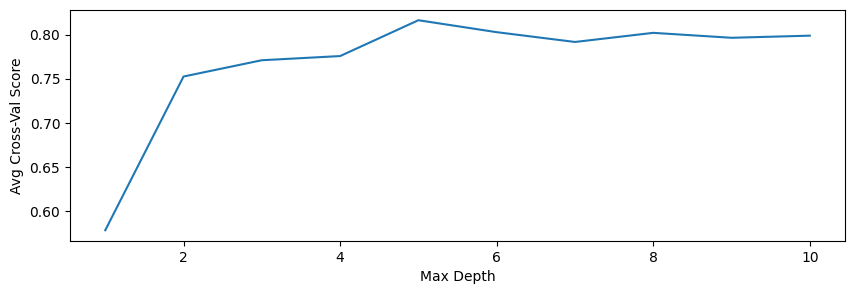

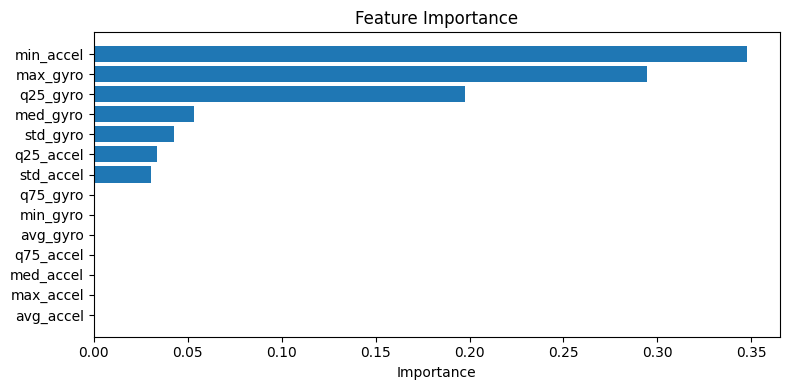

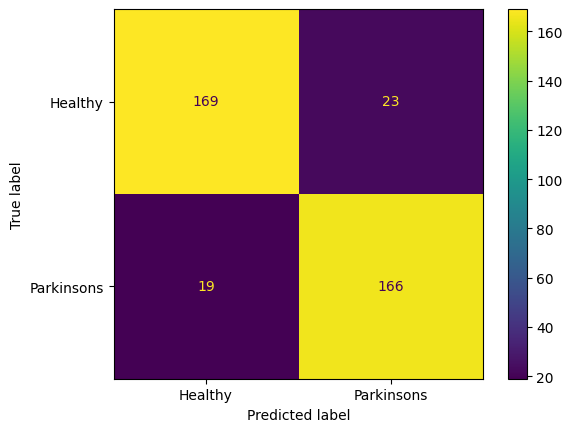

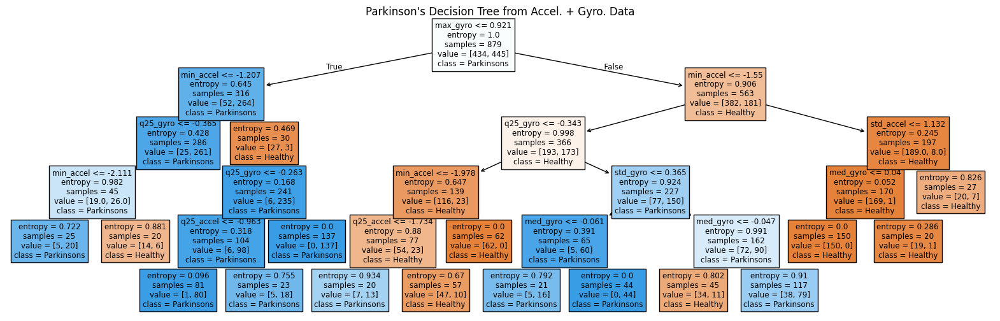

In [29]:
print("MODEL", MODEL)

feature_frames = extract_features(all_accel_data, all_gyro_data, window_sec=WINDOW_SIZE, sample_rate=100, window_type=WINDOW_TYPE)

# Choose the features to train the model on
ALL_FEATURES = ["avg_accel", "max_accel", "med_accel", "min_accel", "q25_accel", "q75_accel", "std_accel", "dominant_freq_accel", "signal_energy_accel", 
                "avg_gyro",  "max_gyro",  "med_gyro",  "min_gyro",  "q25_gyro",  "q75_gyro",  "std_gyro",  "dominant_freq_gyro",  "signal_energy_gyro"]

IGNORED_FEATURES = list(set(ALL_FEATURES) - set(TRAINING_FEATURES))

feature_frames = feature_frames.drop(columns=IGNORED_FEATURES)

# Adjust the max_depth of the tree to avoid overfitting
show_depth_accuracy(feature_frames, NUM_TREES)
print("MAX DEPTH", MAX_DEPTH)

dt_model, dt_cm, acc = train_decision_tree(feature_frames, NUM_TREES, MAX_DEPTH)

show_feature_importance(dt_model, feature_frames.columns)

# Display the confusion matrix
cm_display = ConfusionMatrixDisplay(confusion_matrix = dt_cm, display_labels=dt_model.classes_)
cm_display.plot()

# Visualize the tree
if NUM_TREES == 1:
    show_decision_tree(dt_model, feature_frames, feature_frames['label'].unique().tolist())